In [14]:
%load_ext autoreload
%autoreload 2


In [15]:
import os
import glob
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import random

from sklearn.model_selection import train_test_split

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from colorama import Fore, Back, Style
c_  = Fore.GREEN
sr_ = Style.RESET_ALL

import time
from collections import defaultdict
import copy

from utils.dataset import EchoDataset
from utils.train import *
from utils.evaluation import *
from utils.optimizer import *
from utils.utils import *

In [16]:

### Logging part
import logging
from datetime import datetime
from pytz import timezone
import sys

import random

def seed_everything(seed=1):
    """ Seed and GPU setting """
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    # torch.backends.cudnn.benchmark = True

def log(CFG):
    logger = logging.getLogger()
    logger.setLevel(logging.INFO)
    def timetz(*args):
        return datetime.now(tz).timetuple()
    tz = timezone('Asia/Seoul')
    logging.Formatter.converter = timetz

    formatter = logging.Formatter('%(asctime)s - %(name)s - %(levelname)s - %(message)s')
    # log 출력
    stream_handler = logging.StreamHandler()
    stream_handler.setFormatter(formatter)
    logger.addHandler(stream_handler)

    # log를 파일에 출력
    file_handler = logging.FileHandler(os.path.join('saved_model',CFG['exp_name'], f'init_{opt.type}.log'))
    file_handler.setFormatter(formatter)
    logger.addHandler(file_handler)

    logger.info(f"python {' '.join(sys.argv)}")
    logger.info("Timezone: " + str(tz))
    logger.info(f"Training Start")
    return logger


In [17]:
def seed_everything(seed: int=0):    
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = True


In [19]:
dataset_dir = '../dataset/EchoNet-LVH/dataset'
# dataset_dir = 'dataset'

In [25]:
data_list = glob.glob(os.path.join(dataset_dir, '*', '*.avi'))
label_df = pd.read_csv(os.path.join(dataset_dir, 'MeasurementsList.csv'), index_col=0)
data_list = [os.path.basename(data_path).split('.')[0] for data_path in data_list]
calc_list = ['LVPWd', 'LVIDd', 'IVSd']

In [26]:
data_df = label_df[label_df['HashedFileName'].apply(lambda x: x in data_list)]
data_df = data_df[data_df['Calc'].apply(lambda x: x in calc_list)]
data_df.reset_index(drop=True, inplace=True)
# 3개의 점이 반드시 존재하는 리스트
perfect_list = [filename for filename in data_df['HashedFileName'].unique() if len(data_df[data_df['HashedFileName'] == filename])==3]
data_df = data_df[data_df['HashedFileName'].apply(lambda x: x in perfect_list)]
data_df.reset_index(drop=True, inplace=True)


In [29]:
data_df.to_csv('dataset/MeasurementsList.csv')

## Data Selection

In [30]:
data_df

,HashedFileName,Calc,CalcValue,Frame,X1,X2,Y1,Y2,Frames,FPS,Width,Height,split
0,0X74FA16DE8ADD4FE6,LVPWd,0.906732,36,466,478,544,508,130,19.969,1024.0,768,train
1,0X74FA16DE8ADD4FE6,LVIDd,4.256507,36,478,540,508,341,130,19.969,1024.0,768,train
2,0X74FA16DE8ADD4FE6,IVSd,0.861528,36,540,552,341,307,130,19.969,1024.0,768,train
3,0X2EA926F54F8301D7,LVPWd,0.880773,58,412,432,594,560,211,19.971,1024.0,768,val
4,0X2EA926F54F8301D7,IVSd,0.892301,58,533,554,379,345,211,19.971,1024.0,768,val
...,...,...,...,...,...,...,...,...,...,...,...,...,...
709,0X3AE13B776E62F444,LVPWd,1.220124,39,354,385,583,538,155,19.968,1024.0,768,train
710,0X3AE13B776E62F444,IVSd,1.353223,39,498,535,369,321,155,19.968,1024.0,768,train
711,0X4C9C1980FBCEE61D,LVIDd,4.774580,40,455,575,594,397,156,19.968,1024.0,768,train
712,0X4C9C1980FBCEE61D,LVPWd,0.695488,40,435,455,621,594,156,19.968,1024.0,768,train


In [31]:
a = data_df[data_df['HashedFileName'] == '0X74FA16DE8ADD4FE6']

In [32]:
a[a['Calc'] == 'LVPWd'][['X1', 'X2', 'Y1', 'Y2']].to_numpy().shape

(1, 4)

In [33]:
int(a[a['Calc'] == 'LVPWd']['Frames'])

130

In [124]:
def show_lvh(sample):
    image = sample[0][0].squeeze().permute(1,2,0)
    plt.figure(figsize=(15,10))
    plt.imshow(image)
    for coor in sample[1]:
        coor = coor.squeeze()
        plt.plot((coor[0], coor[1]),
                (coor[2], coor[3]), linewidth=3)
        plt.scatter((coor[0], coor[1]), (coor[2], coor[3]), )
    plt.axis('off')
    plt.show()

In [125]:
ds = EchoDataset(root=dataset_dir)

In [126]:
dl = DataLoader(ds, batch_size=1, shuffle=False)

In [127]:
s = dl.__iter__().__next__()

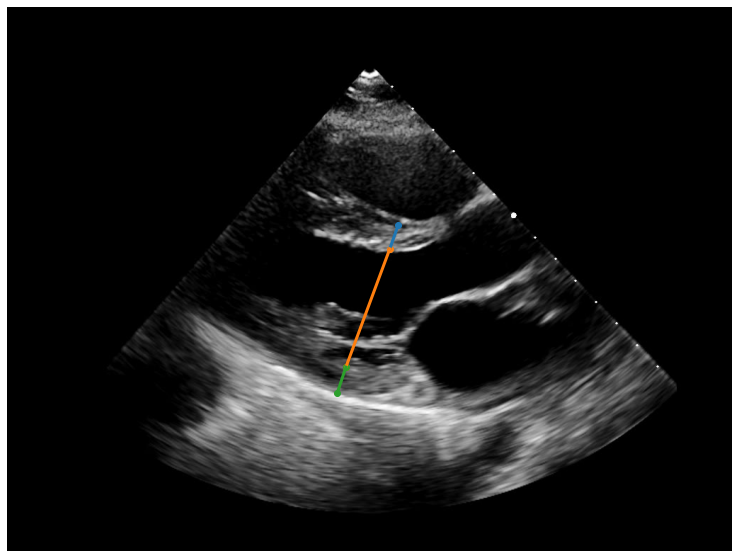

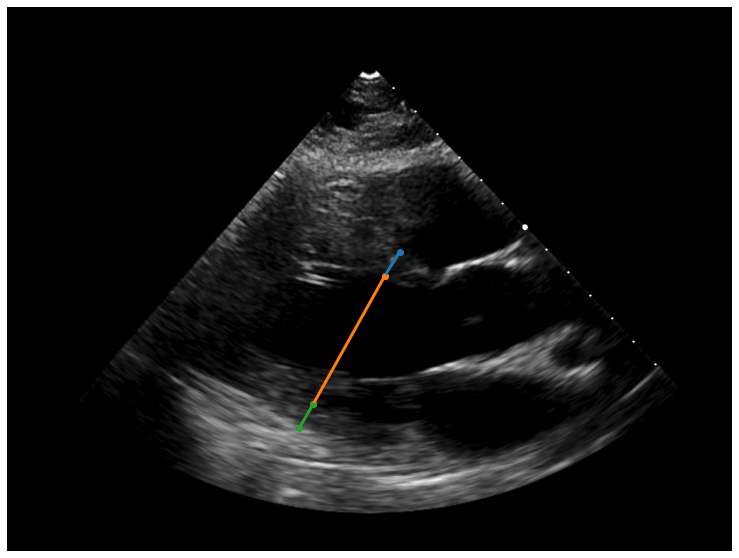

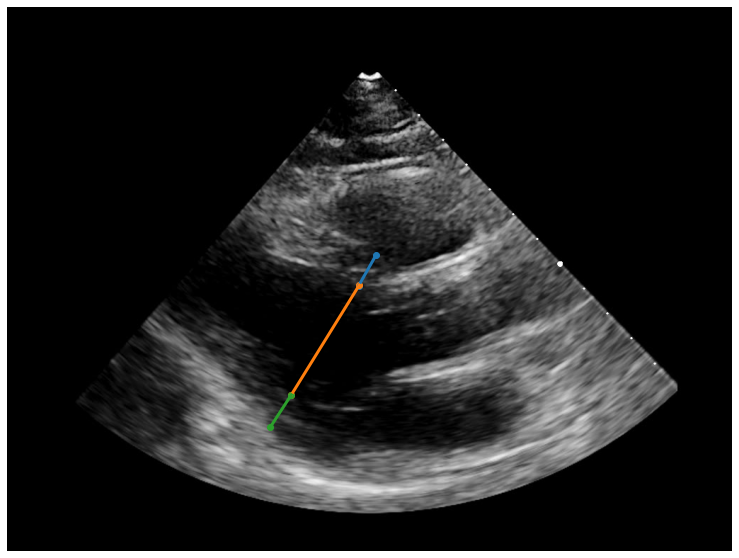

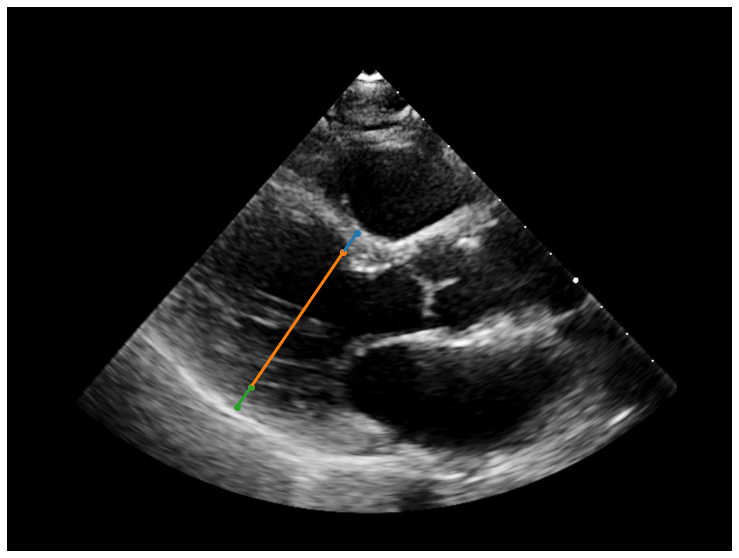

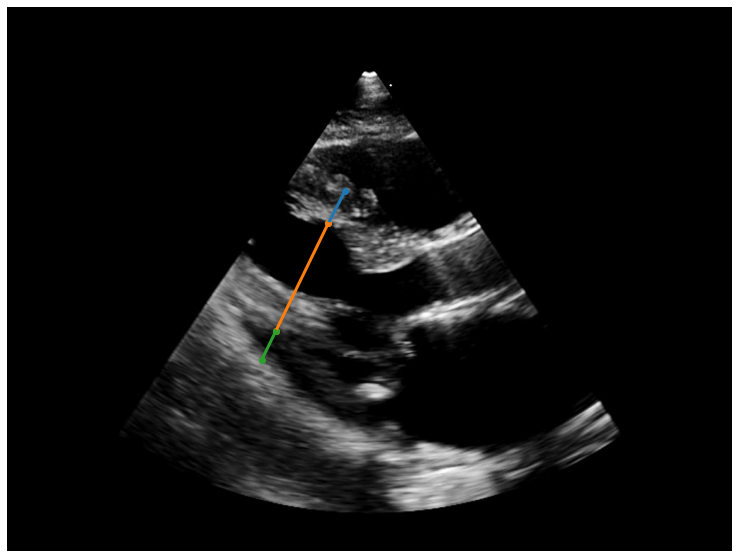

...

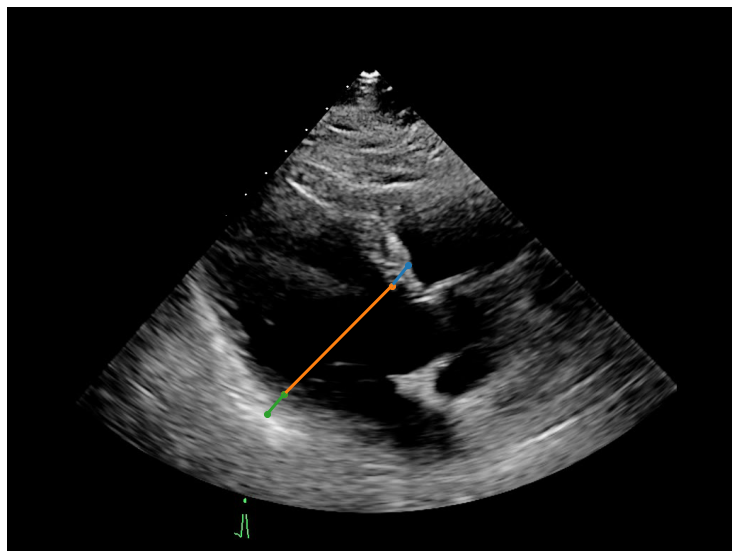

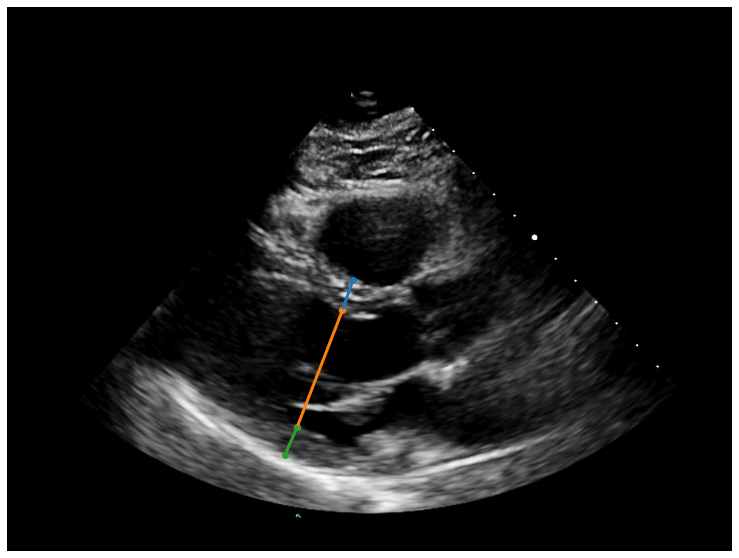

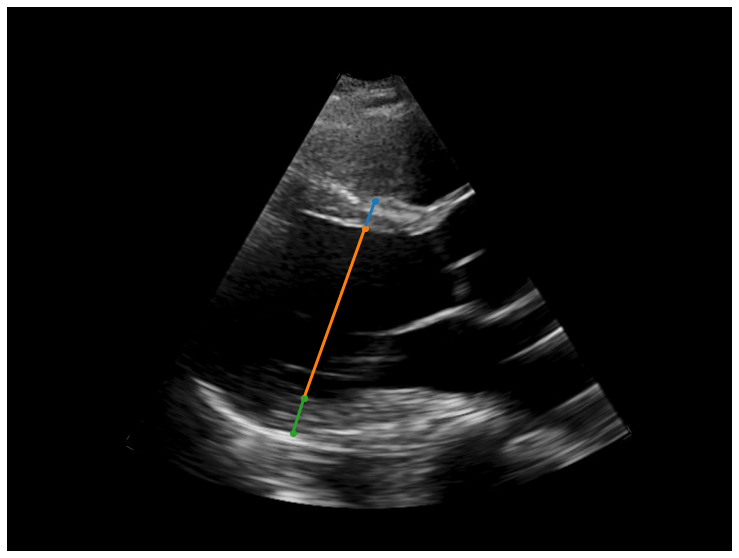

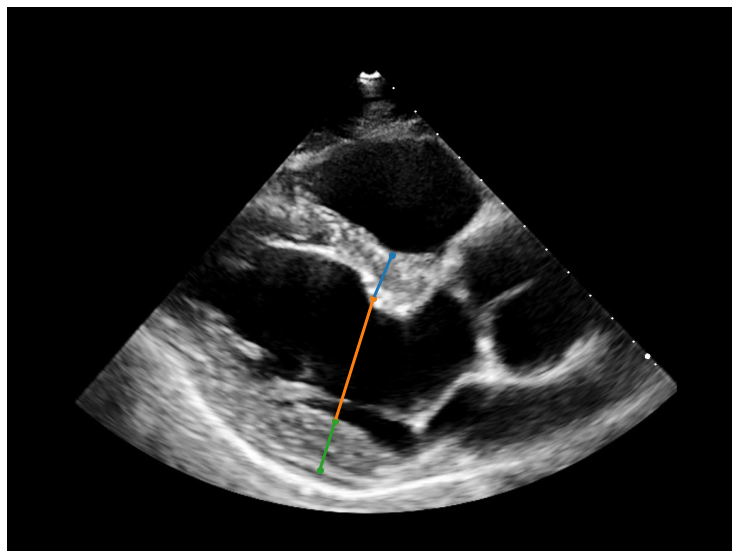

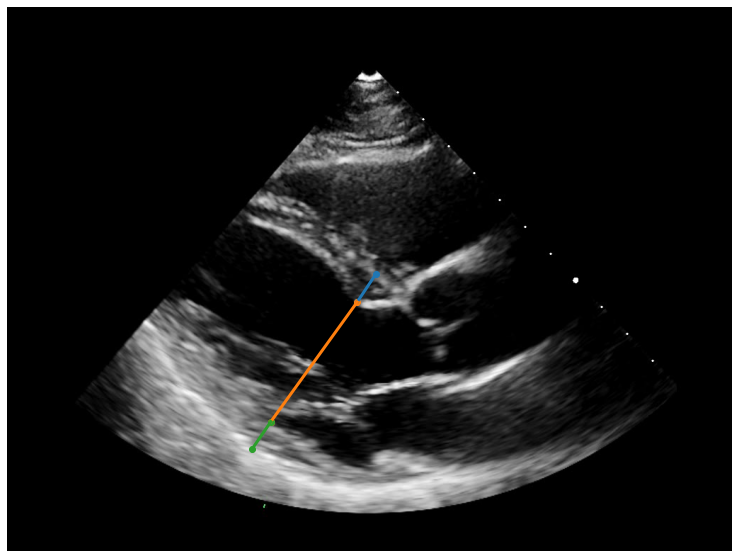

KeyboardInterrupt: 

In [128]:
for sample in dl:
    show_lvh(sample)

In [ ]:

def run_training(model, train_dl, val_dl, optimizer, scheduler, criterion, CFG):
    """
    모델, 데이터를 받아 학습/검증 수행후 결과에 대해 출력 및 모델 저장
    """
    device = CFG['device']
    num_epochs = CFG['epochs']
    start = time.time()
    early_stopping = EarlyStopping(patience=CFG['optimizer']['patience'], verbose=True, trace_func=trace_func)

    best_model_wts = copy.deepcopy(model.state_dict())
    best_mde = np.inf
    best_epoch = -1
    history = defaultdict(list)
    # 에폭만큼 학습 수행
    for epoch in range(1, num_epochs+1):
        gc.collect()
        # 에폭 단위 학습 수행
        train_loss, train_mde = train_one_epoch(model=model, dataloader=train_dl, optimizer=optimizer, scheduler=scheduler, device=device, criterion=criterion, CFG=CFG)
        # 에폭 단위 검증 수행
        val_loss, val_mde = valid_one_epoch(model=model, dataloader=val_dl, device=device, criterion=criterion, CFG=CFG)
        early_stopping(val_loss, model)

        history['Train Loss'].append(train_loss)
        history['Train MDE'].append(train_mde)
        history['Valid Loss'].append(val_loss)
        history['Valid MDE'].append(val_mde)
        trace_func(f"[Epoch {epoch}/{CFG['epochs']}: Train Loss: {train_loss:.5f}, Val Loss: {val_loss:.5f}, Train MDE: {train_mde:.5f}, Val MDE: {val_mde:.5f}")
        
        if scheduler is not None:
            scheduler.step()
        # validation MDE가 개선이 된 경우 모델을 저장
        if val_mde <= best_mde:
            trace_func(f"Valid Score Improved ({best_mde:.4f} ---> {val_mde:.4f})")
            best_mde = val_mde
            best_epoch = epoch
            best_model_wts = copy.deepcopy(model.state_dict())

            model_name = f"best_epoch-init_{CFG['type']}.pth"
            torch.save(model.state_dict(), os.path.join(f'saved_model/{opt.exp_name}', model_name))

            trace_func(f"Model Saved")
        if early_stopping.early_stop:
            trace_func("Early stopping")
            break

    model_name = f"last_epoch-init_{CFG['type']}.pth"
    torch.save(model.state_dict(), os.path.join(f'saved_model/{opt.exp_name}', model_name))
    end = time.time()
    time_elapsed = end-start
    trace_func("Trianing complete in {:.0f}h {:.0f}m {:.0f}s".format(time_elapsed//3600, (time_elapsed%3600)//60, (time_elapsed%3600)%60))
    trace_func("Best Val MDE: {:.4f}".format(best_mde))

    model.load_state_dict(best_model_wts)

    return model, history